# Probability Distributions
Part of the Bayesian neural networks via MCMC: a Python-based tutorial

This section of the tutorial covers the some basic types of probability distributions.

In [1]:
import numpy as np
from numpy import random
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from math import sqrt
from scipy.stats import norm, gamma, invgamma

In [35]:
# Step 1: Install Git if necessary
!apt-get install git

# Step 2: Clone the GitHub repository
!git clone https://github.com/OpenSourceEcon/CompMethods.git

# Step 3: Change directory to the cloned repository
%cd CompMethods

# Step 4: List files to confirm the repository is cloned
!ls

# Step 5: Add the repository to the Python path
import sys
sys.path.append('/kaggle/working/CompMethods')

#


Reading package lists... Done
Building dependency tree       
Reading state information... Done
git is already the newest version (1:2.25.1-1ubuntu3.11).
0 upgraded, 0 newly installed, 0 to remove and 54 not upgraded.
Cloning into 'CompMethods'...
remote: Enumerating objects: 1851, done.
remote: Counting objects: 100% (405/405), done.
remote: Compressing objects: 100% (219/219), done.
remote: Total 1851 (delta 232), reused 329 (delta 171), pack-reused 1446
Receiving objects: 100% (1851/1851), 21.75 MiB | 31.78 MiB/s, done.
Resolving deltas: 100% (1029/1029), done.
/kaggle/working/CompMethods
CHANGELOG.md  Makefile	 code  docs		images	  tests
LICENSE       README.md  data  environment.yml	setup.py


In [2]:
# set plot styling
sns.set_style('darkgrid')
sns.set_context('paper')
# set random seed
np.random.seed(2022)

In [3]:
def plot_distributions(x_data, pdf_data,title=''):
    '''
    Construct a matplotlib plot comparing the pdf_data.
    Inputs:
        x_data: 1d array of x values
        pdf_data: dict of {label: probability density values}
    '''
    plt.title(title)
    for label, pdf in pdf_data.items():
        plt.plot(x_data, pdf, label=label)
    plt.legend()
    plt.xlabel(r"$x$")
    plt.ylabel(r"$f(x)$")

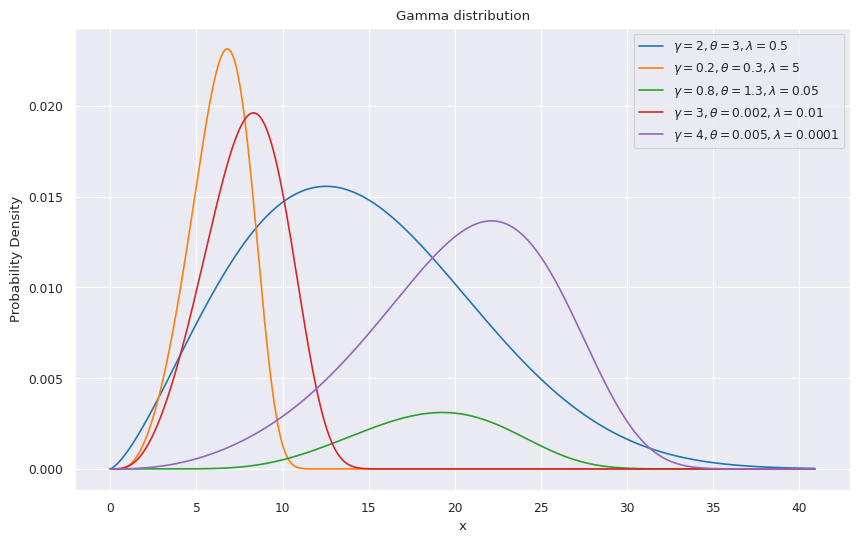

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import gamma

def gamma_pdf(gamma_param, theta, lambd, x):
    # Calculate common terms
    term1 = 1 + 2 * theta * x
    term2 = np.exp(-2 * theta * x)
    
    # Calculate the main components of the expression
    numerator = gamma_param * (theta ** 2) * x * term2
    inner_term = 1 - term1 * term2
    numerator_exp = (inner_term ** lambd)
    denominator_exp = (1 - inner_term ** lambd) ** 2
    
    # Calculate the exponential part
    exp_term = np.exp(-gamma_param * numerator_exp / (1 - inner_term ** lambd))
    
    # Final expression
    result = numerator * (numerator_exp / denominator_exp) * exp_term
    
    return result
  
def plot_distributions(x, pdf_data, title=''):
    plt.figure(figsize=(10, 6))
    for label, pdf in pdf_data.items():
        plt.plot(x, pdf, label=label)
    plt.title(title)
    plt.xlabel('x')
    plt.ylabel('Probability Density')
    plt.legend()
    plt.grid(True)
    plt.show()

x = np.linspace(0, 40.9, 1000)

pdf_data = {
    r'$\gamma=2, \theta=3, \lambda=0.5$': gamma_pdf(gamma_param=.2, theta=.03, lambd=0.05, x=x),
    r'$\gamma=0.2, \theta=0.3, \lambda=5$': gamma_pdf(gamma_param=.2, theta=0.3, lambd=2, x=x),
    r'$\gamma=0.8, \theta=1.3, \lambda=0.05$': gamma_pdf(gamma_param=0.8, theta= .1, lambd= 6, x=x),
    r'$\gamma=3, \theta=0.002, \lambda=0.01$': gamma_pdf(gamma_param=.3, theta=0.2, lambd=1.5, x=x),
    r'$\gamma=4, \theta=0.005, \lambda=0.0001$': gamma_pdf(gamma_param= .08, theta=   .1, lambd=1.1, x=x)
}

plot_distributions(
    x,
    pdf_data,
    title='Gamma distribution'
)


/tmp/ipykernel_33/3474192485.py:13: RuntimeWarning: divide by zero encountered in divide
  result = numerator * (numerator_exp / denominator_exp)


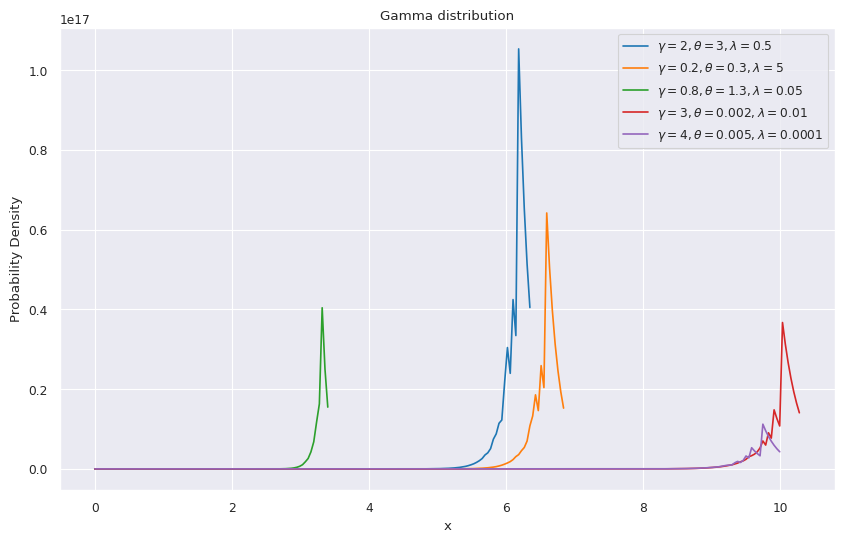

In [5]:
 
def gamma_hf(gamma_param, theta, lambd, x):
    # Calculate common terms
    term1 = 1 + 2 * theta * x
    term2 = np.exp(-2 * theta * x)
    
    # Calculate the main components of the expression
    numerator = gamma_param * (theta ** 2) * x * term2
    inner_term = 1 - term1 * term2
    numerator_exp = (inner_term ** lambd)
    denominator_exp = (1 - inner_term ** lambd) ** 2
     
    # Final expression
    result = numerator * (numerator_exp / denominator_exp)  
    
    return result
  
def plot_distributions(x, pdf_data, title=''):
    plt.figure(figsize=(10, 6))
    for label, pdf in pdf_data.items():
        plt.plot(x, pdf, label=label)
    plt.title(title)
    plt.xlabel('x')
    plt.ylabel('Probability Density')
    plt.legend()
    plt.grid(True)
    plt.show()

x = np.linspace(0, 40.9, 1000)

pdf_data = {
    r'$\gamma=2, \theta=3, \lambda=0.5$': gamma_hf(gamma_param=.3, theta=3, lambd=0.05, x=x),
    r'$\gamma=0.2, \theta=0.3, \lambda=5$': gamma_hf(gamma_param=2, theta= 3, lambd= .5, x=x),
    r'$\gamma=0.8, \theta=1.3, \lambda=0.05$': gamma_hf(gamma_param=.8, theta= 6, lambd= .6, x=x),
    r'$\gamma=3, \theta=0.002, \lambda=0.01$': gamma_hf(gamma_param=3, theta=2, lambd=  1, x=x),
    r'$\gamma=4, \theta=0.005, \lambda=0.0001$': gamma_hf(gamma_param= .3, theta=2, lambd=.3, x=x)
}

plot_distributions(
    x,
    pdf_data,
    title='Gamma distribution'
)


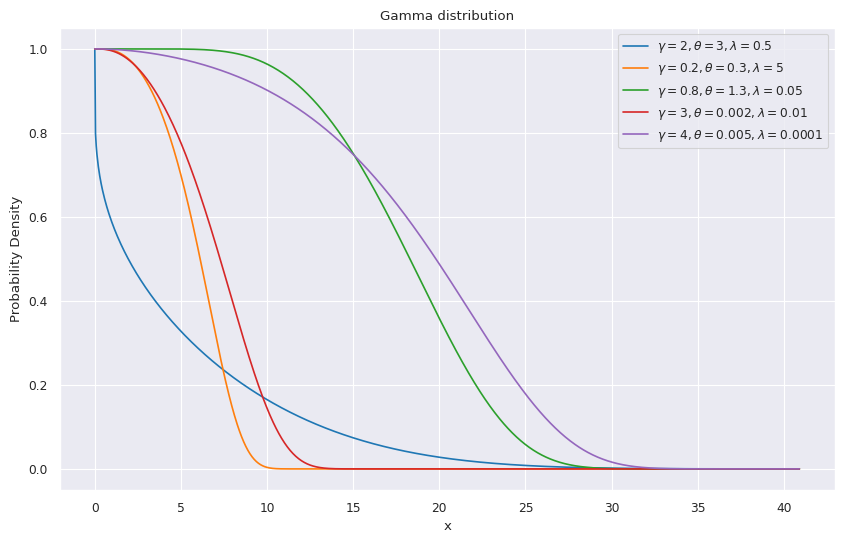

In [6]:
 
def gamma_sf(gamma_param, theta, lambd, x):
    # Calculate common terms
    term1 = 1 + 2 * theta * x
    term2 = np.exp(-2 * theta * x)
    
    # Calculate the main components of the expression
    inner_term = 1 - term1 * term2
    numerator_exp = (inner_term ** lambd)
     
    # Calculate the exponential part
    result   = np.exp(-gamma_param * numerator_exp / (1 - inner_term ** lambd))
    
     
    return result
  
def plot_distributions(x, pdf_data, title=''):
    plt.figure(figsize=(10, 6))
    for label, pdf in pdf_data.items():
        plt.plot(x, pdf, label=label)
    plt.title(title)
    plt.xlabel('x')
    plt.ylabel('Probability Density')
    plt.legend()
    plt.grid(True)
    plt.show()

x = np.linspace(0, 40.9, 1000)

pdf_data = {
    r'$\gamma=2, \theta=3, \lambda=0.5$': gamma_sf(gamma_param=.2, theta=.03, lambd=0.05, x=x),
    r'$\gamma=0.2, \theta=0.3, \lambda=5$': gamma_sf(gamma_param=.2, theta=0.3, lambd=2, x=x),
    r'$\gamma=0.8, \theta=1.3, \lambda=0.05$': gamma_sf(gamma_param=0.8, theta= .1, lambd= 6, x=x),
    r'$\gamma=3, \theta=0.002, \lambda=0.01$': gamma_sf(gamma_param=.3, theta=0.2, lambd=1.5, x=x),
    r'$\gamma=4, \theta=0.005, \lambda=0.0001$': gamma_sf(gamma_param= .08, theta=   .1, lambd=1.1, x=x)
}

plot_distributions(
    x,
    pdf_data,
    title='Gamma distribution'
)


Time:  0.03913378715515137
Rejection:  84836


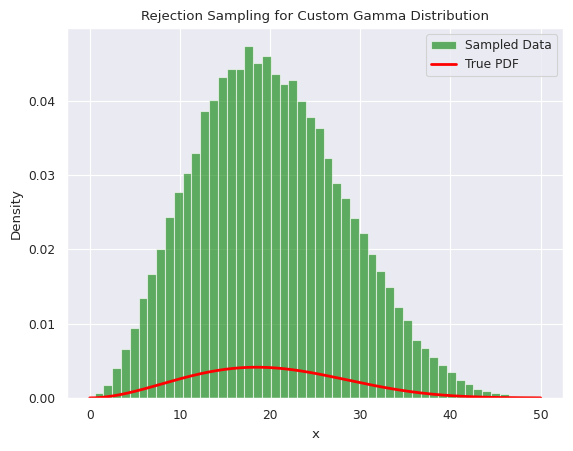

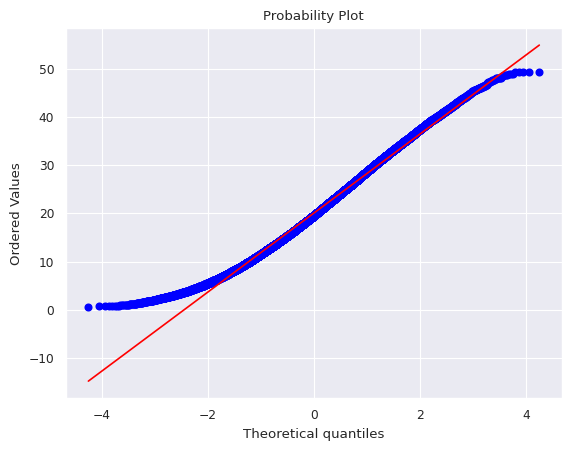

((array([7.09127222e-06, 1.72128842e-05, 2.74434245e-05, ...,
         5.00000000e+01, 5.00000000e+01, 5.00000000e+01]),
  array([ 0.53087724,  0.7486239 ,  0.7734223 , ..., 49.25825651,
         49.37196149, 49.3784483 ])),
 (0.31815829951637215, 4.6795039534797915, 0.35236722776696644))

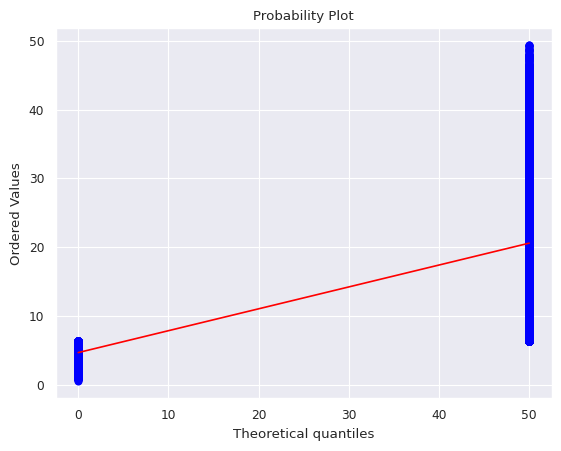

In [7]:
import random
import matplotlib.pyplot as plt
import numpy as np
import time
import scipy.stats as ss

# Define the custom gamma PDF function
def gamma_pdf(gamma_param, theta, lambd, x):
    # Calculate common terms
    term1 = 1 + 2 * theta * x
    term2 = np.exp(-2 * theta * x)
    
    # Calculate the main components of the expression
    numerator = gamma_param * (theta ** 2) * x * term2
    inner_term = 1 - term1 * term2
    numerator_exp = (inner_term ** lambd)
    denominator_exp = (1 - inner_term ** lambd) ** 2
    
    # Calculate the exponential part
    exp_term = np.exp(-gamma_param * numerator_exp / (1 - inner_term ** lambd))
    
    # Final expression
    result = numerator * (numerator_exp / denominator_exp) * exp_term
    
    return result

# Parameters for the custom gamma distribution
gamma_param, theta, lambd = 1.2, 0.03, 0.5

# Define the range for x values
a = 0   # xmin
b = 50   # xmax

# Find the maximum value of the PDF for scaling
x_values = np.linspace(a, b, 1000)
pdf_values = gamma_pdf(gamma_param, theta, lambd, x_values)
m = np.max(pdf_values)  # ymax

variables = []  # list for variables
reject = 0      # number of rejections
start = time.time()

# Number of samples before accept-reject
n_before_accept_reject = 150000
u1 = np.random.uniform(a, b, size=n_before_accept_reject)
u2 = np.random.uniform(0, m, size=n_before_accept_reject)

# Perform rejection sampling
variables = u1[u2 <= gamma_pdf(gamma_param, theta, lambd, u1)]
accept = np.extract(variables>=0.0, variables)
reject = n_before_accept_reject - len(accept)

#reject = n_before_accept_reject - len(variables)

end = time.time()

print("Time: ", end - start)
print("Rejection: ", reject)

# Plot the results
x = np.linspace(a, b, 1000)
plt.hist(variables, 50, density=True, alpha=0.6, color='g', label='Sampled Data')
plt.plot(x, gamma_pdf(gamma_param, theta, lambd, x), 'r-', lw=2, label='True PDF')
plt.title('Rejection Sampling for Custom Gamma Distribution')
plt.xlabel('x')
plt.ylabel('Density')
plt.legend()
plt.show()

# Q-Q plot to compare the sampled data to the theoretical distribution
ss.probplot(variables, dist="norm", plot=plt)
plt.show()
 
class my_pdf(ss.rv_continuous):
    def _pdf(self, x):
        return 1.5 * (1.0 - x*x)

ss.probplot(accept, dist=my_pdf(a=a, b=b, name='my_pdf'), plot=plt)



In [9]:
import numpy as np

def prior(a1, a2, a3, b1, b2, b3, theta, lambd):
    prior_value = (gamma**(a1 - 1)) * (theta**(a2 - 1)) * (lambd**(a3 - 1)) * np.exp(-gamma * b1 - theta * b2 - lambd * b3)
    return prior_value

def posterior(n, a1, a2, a3, b1, b2, b3, theta, lambd, x):
    term1 = 1 + 2 * theta * x
    term2 = np.exp(-2 * theta * x)
    
    product_term = x * (1 - term1 * term2) ** lambd / (1 - (1 - term1 * term2) ** lambd) ** 2
    sum_term1 = np.sum((1 - term1 * term2) ** lambd / (1 - (1 - term1 * term2) ** lambd)) + b1
    sum_term2 = 2 * np.sum(x) + b2

    exp_term = np.exp(-gamma * sum_term1 - theta * sum_term2 - lambd * b3)
    
    P_Theta = (gamma**(n + a1 - 1)) * (theta**(2 * n + a2 - 1)) * (lambd**(a3 - 1)) * np.prod(product_term) * exp_term
    return P_Theta

# Example usage
a1 = 1.0
a2 = 1.0
a3 = 1.0
b1 = 1.0
b2 = 1.0
b3 = 1.0
theta = 0.5
lambd = 2.0
x = np.array([1, 2, 3, 4, 5])

prior_value = prior(a1, a2, a3, b1, b2, b3, theta, lambd)
posterior_value = posterior(len(x), a1, a2, a3, b1, b2, b3, theta, lambd, x)

print(f"Prior \u03C0(\u0398): {prior_value}")
print(f"Posterior P(\u0398): {posterior_value}")


Prior π(Θ): 0.06720551273974976
Posterior P(Θ): 2.434640704816467e-11


In [11]:
import numpy as np
from scipy.optimize import minimize

# Generate some data from a normal distribution
np.random.seed(42)

# Example data
x = variables[variables != 0]

def log_likelihood(params, x):
    theta, lambd = params
    
    n = len(x)
    term1 = 1 + 2 * theta * x
    term2 = np.exp(-2 * theta * x)
    
    # Add small constants to prevent log(0) and division by zero
    
    log_product_term = np.log(x ) + lambd * np.log(1 - term1 * term2 ) - 2 * np.log(1 - (1 - term1 * term2) ** lambd )
    sum_term = -2 * theta * np.sum(x) - gamma_param * np.sum((1 - term1 * term2) ** lambd / (1 - (1 - term1 * term2) ** lambd ))
    
    l_Theta = n * np.log(gamma_param * theta ** 2 ) + np.sum(log_product_term) + sum_term
    return -l_Theta

# Provide the initial guess for the parameters
initial_guess = [ 3, 5]

# Perform the minimization
result = minimize(log_likelihood, x0=initial_guess, args=(x,), method='L-BFGS-B')

# Extract the MLE estimates
theta_mle, lambd_mle = result.x
print(f"MLE estimates: theta={theta_mle:.2f}, lambd={lambd_mle:.2f}")


/tmp/ipykernel_33/2746727861.py:19: RuntimeWarning: divide by zero encountered in log
  log_product_term = np.log(x ) + lambd * np.log(1 - term1 * term2 ) - 2 * np.log(1 - (1 - term1 * term2) ** lambd )
/tmp/ipykernel_33/2746727861.py:20: RuntimeWarning: divide by zero encountered in divide
  sum_term = -2 * theta * np.sum(x) - gamma_param * np.sum((1 - term1 * term2) ** lambd / (1 - (1 - term1 * term2) ** lambd ))
/tmp/ipykernel_33/2746727861.py:22: RuntimeWarning: invalid value encountered in scalar add
  l_Theta = n * np.log(gamma_param * theta ** 2 ) + np.sum(log_product_term) + sum_term


MLE estimates: theta=3.00, lambd=5.00


In [13]:
import numpy as np
from scipy.optimize import minimize

# Generate some data from a normal distribution
np.random.seed(42)

# Example data
x = variables[variables != 0]

def log_likelihood(params, x):
    theta, lambd = params
    
    n = len(x)
    term1 = 1 + 2 * theta * x
    term2 = np.exp(-2 * theta * x)
    
    # Prevent log(0) and division by zero by adding a small constant
    epsilon = 1e-10
    safe_x = np.maximum(x, epsilon)
    safe_term1_term2 = np.maximum(term1 * term2, epsilon)
    
    # Calculate intermediate terms
    log_product_term = np.log(safe_x) + lambd * np.log(1 - safe_term1_term2) - 2 * np.log(1 - (1 - safe_term1_term2) ** lambd)
    sum_term = -2 * theta * np.sum(safe_x) - gamma_param * np.sum((1 - safe_term1_term2) ** lambd / (1 - (1 - safe_term1_term2) ** lambd))

    # Calculate log-likelihood
    l_Theta = n * np.log(gamma_param * theta ** 2) + np.sum(log_product_term) + sum_term
    
    """ # Print intermediate values for debugging
    print("Params:", params)
    print("Term1:", term1)
    print("Term2:", term2)
    print("Safe term1 * term2:", safe_term1_term2)
    print("Log product term:", log_product_term)
    print("Sum term:", sum_term)
    print("Log-likelihood:", l_Theta)
    
    """    
    return -l_Theta

# Provide the initial guess for the parameters
initial_guess = [.3, 5]

# Perform the minimization
result = minimize(log_likelihood, x0=initial_guess, args=(x,), method='L-BFGS-B')

# Extract the MLE estimates
theta_mle, lambd_mle = result.x
print(f"MLE estimates: theta={theta_mle:.2f}, lambd={lambd_mle:.2f}")


/tmp/ipykernel_33/3072664070.py:23: RuntimeWarning: invalid value encountered in log
  log_product_term = np.log(safe_x) + lambd * np.log(1 - safe_term1_term2) - 2 * np.log(1 - (1 - safe_term1_term2) ** lambd)
/tmp/ipykernel_33/3072664070.py:15: RuntimeWarning: overflow encountered in exp
  term2 = np.exp(-2 * theta * x)
/tmp/ipykernel_33/3072664070.py:20: RuntimeWarning: overflow encountered in multiply
  safe_term1_term2 = np.maximum(term1 * term2, epsilon)


MLE estimates: theta=0.06, lambd=3.80


/tmp/ipykernel_33/3072664070.py:23: RuntimeWarning: overflow encountered in power
  log_product_term = np.log(safe_x) + lambd * np.log(1 - safe_term1_term2) - 2 * np.log(1 - (1 - safe_term1_term2) ** lambd)
/tmp/ipykernel_33/3072664070.py:24: RuntimeWarning: overflow encountered in power
  sum_term = -2 * theta * np.sum(safe_x) - gamma_param * np.sum((1 - safe_term1_term2) ** lambd / (1 - (1 - safe_term1_term2) ** lambd))
/tmp/ipykernel_33/3072664070.py:24: RuntimeWarning: invalid value encountered in divide
  sum_term = -2 * theta * np.sum(safe_x) - gamma_param * np.sum((1 - safe_term1_term2) ** lambd / (1 - (1 - safe_term1_term2) ** lambd))


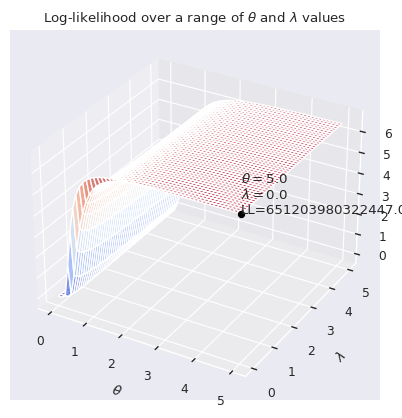

In [16]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

# Assuming variables contains the data from your previous program
# Replace variables with actual data if necessary
#x = variables[variables != 0]

# Set up the parameters for the grid search
points = 50
theta_array = np.linspace(0.001, 5, points)
lambda_array = np.linspace(0.0001, 5, points)

T, L = np.meshgrid(theta_array, lambda_array)

LL = np.empty((len(theta_array), len(lambda_array)))
epsilon = 1e-10
gamma = 1  # Set gamma to 1

for i, theta in enumerate(theta_array):
    for j, lambd in enumerate(lambda_array):
        term1 = 1 + 2 * theta * x
        term2 = np.exp(-2 * theta * x)
        
        safe_x = np.maximum(x, epsilon)
        safe_term1_term2 = np.maximum(term1 * term2, epsilon)
        safe_denominator = np.maximum(1 - (1 - term1 * term2) ** lambd, epsilon)
        safe_numerator_exp = np.maximum((1 - term1 * term2) ** lambd, epsilon)
        
        ll = (
            np.log(gamma * theta**2 * safe_x) -
            2 * theta * x +
            lambd * np.log(1 - safe_term1_term2) -
            2 * np.log(safe_denominator) -
            gamma * safe_numerator_exp / safe_denominator
        )
        
        LL[i][j] = -ll.sum()

LL_max = LL.max()
idx = np.where(LL == LL_max)
theta_fit = theta_array[idx[0]][0]
lambda_fit = lambda_array[idx[1]][0]

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(T, L, LL.transpose(), cmap="coolwarm", linewidth=1, antialiased=True, alpha=0.7, zorder=0)
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\lambda$')
ax.set_zlabel('Log-likelihood')
ax.scatter([theta_fit], [lambda_fit], [LL_max], color='k', zorder=1)
text_string = str(r'$\theta=$'+str(round(theta_fit, 2))+'\n'+r'$\lambda=$'+str(round(lambda_fit, 2))+'\nLL='+str(round(LL_max, 2)))
ax.text(x=theta_fit, y=lambda_fit, z=LL_max+0.1, s=text_string)
ax.computed_zorder = False
plt.title(r'Log-likelihood over a range of $\theta$ and $\lambda$ values')
plt.show()


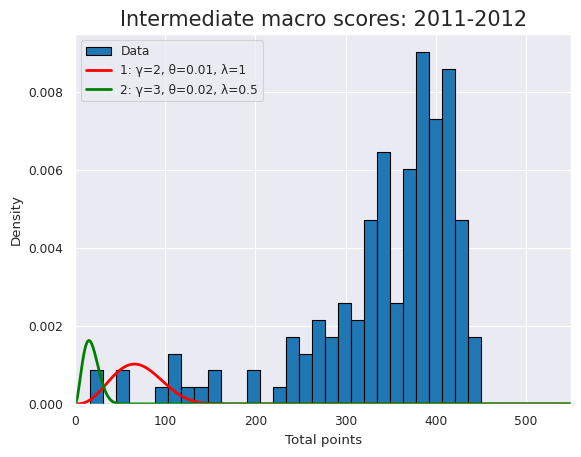

In [36]:
import numpy as np
import matplotlib.pyplot as plt

# Load the data from the specified file path
data_path = '/kaggle/working/CompMethods/data/mle/Econ381totpts.txt'
data = np.loadtxt(data_path)

# Define the gamma_pdf function
def gamma_pdf(gamma_param, theta, lambd, x):
    # Calculate common terms
    term1 = 1 + 2 * theta * x
    term2 = np.exp(-2 * theta * x)
    
    # Calculate the main components of the expression
    numerator = gamma_param * (theta ** 2) * x * term2
    inner_term = 1 - term1 * term2
    numerator_exp = (inner_term ** lambd)
    denominator_exp = (1 - inner_term ** lambd) ** 2
    
    # Calculate the exponential part
    exp_term = np.exp(-gamma_param * numerator_exp / (1 - inner_term ** lambd))
    
    # Final expression
    result = numerator * (numerator_exp / denominator_exp) * exp_term
    
    return result

# Create a histogram of the data
num_bins = 30
count, bins, ignored = plt.hist(data, num_bins, density=True,
                                edgecolor='k', label='Data')
plt.title('Intermediate macro scores: 2011-2012', fontsize=15)
plt.xlabel('Total points')
plt.ylabel('Density')
plt.xlim([0, 550])  # This gives the xmin and xmax to be plotted

# Plot smooth line with distribution 1
dist_pts = np.linspace(0, 550, 200)
gamma_1, theta_1, lambd_1 = 2, 0.01, 1
plt.plot(dist_pts, gamma_pdf(gamma_1, theta_1, lambd_1, dist_pts),
         linewidth=2, color='r', label=f'1: γ={gamma_1}, θ={theta_1}, λ={lambd_1}')
plt.legend(loc='upper left')

# Plot smooth line with distribution 2
gamma_2, theta_2, lambd_2 = 3, 0.02, 0.5
plt.plot(dist_pts, gamma_pdf(gamma_2, theta_2, lambd_2, dist_pts),
         linewidth=2, color='g', label=f'2: γ={gamma_2}, θ={theta_2}, λ={lambd_2}')
plt.legend(loc='upper left')

plt.show()


Generated numbers:  [34.27037971 24.34940341 18.40222185 ... 22.63331627 36.14789874
  4.69511549]
First 10 generated numbers:  [34.27037971 24.34940341 18.40222185 24.74188149 16.97547373  4.82165388
 14.6249737  19.44214201 10.60959247 23.75903521]


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


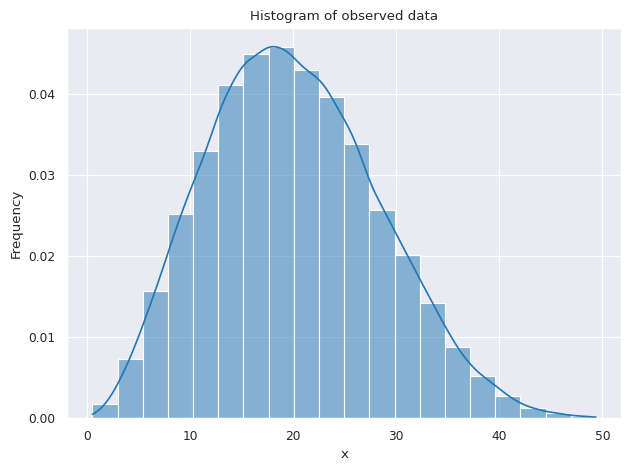

In [17]:
# Print the generated numbers
print("Generated numbers: ", variables)
# Print the first few generated numbers
print("First 10 generated numbers: ", variables[:10])

data = variables

# histogram using seaborn (sns)
# plotting using random number generation
ax = plt.subplot()
sns.histplot(data, kde=True, bins=20, ax=ax, stat="density") # smooth using KDE: https://en.wikipedia.org/wiki/Kernel_density_estimation
_ = ax.set(title='Histogram of observed data', xlabel='x', ylabel='Frequency');
plt.tight_layout()
plt.show()
None



In [18]:
# Convert the generated numbers to a Pandas DataFrame
df = pd.DataFrame(variables, columns=['Generated Numbers'])

# Display the DataFrame
print(df) 


       Generated Numbers
0              34.270380
1              24.349403
2              18.402222
3              24.741881
4              16.975474
...                  ...
65159          22.656590
65160          35.677334
65161          22.633316
65162          36.147899
65163           4.695115

[65164 rows x 1 columns]


In [19]:
# Find the minimum and maximum values
min_value = df['Generated Numbers'].min()
max_value = df['Generated Numbers'].max()
y = df['Generated Numbers'] 

print("Minimum value: ", min_value)
print("Maximum value: ", max_value)
print("All value: ", y)


Minimum value:  0.5308772418288921
Maximum value:  49.37844830383792
All value:  0        34.270380
1        24.349403
2        18.402222
3        24.741881
4        16.975474
           ...    
65159    22.656590
65160    35.677334
65161    22.633316
65162    36.147899
65163     4.695115
Name: Generated Numbers, Length: 65164, dtype: float64


In [20]:
import plotly.graph_objects as go
import numpy as np
# Generate sample data
x = np.linspace(0, 50, 10000)
# Create a basic line plot
fig = go.Figure(data=go.Scatter(x=x, y=y, mode='lines'))
# Add title and labels
fig.update_layout(title='Basic Line Plot', xaxis_title='X-axis', yaxis_title='Y-axis')
# Show the plot
fig.show()

In [21]:
 
import plotly.express as px
import pandas as pd
# Generate sample data
# Generate a scatter plot using Plotly
# Create a DataFrame for scatter plot
scatter_df = pd.DataFrame({
    'X': variables,
    'Y': np.random.rand(len(variables)),
    'Size': np.random.rand(len(variables)) *  300 
})

# Create a scatter plot with color gradient
fig = px.scatter(scatter_df, x='X', y='Y', size='Size', color='Size', title='Scatter Plot with Color Gradient')
# Show the plot
fig.show()

In [22]:
import plotly.graph_objects as go
import numpy as np
import pandas as pd

# Assume `variables` contains the generated data
# For simplicity, we will use only a subset of `variables` for plotting
variables = np.random.choice(variables, size=1000, replace=False)

# Create a meshgrid for x and y based on the generated data
x = np.linspace(min(variables), max(variables), 100)
y = np.linspace(min(variables), max(variables), 100)
x, y = np.meshgrid(x, y)

# Define a function to compute z values based on x and y
def compute_z(x, y):
    return gamma_pdf(gamma_param, theta, lambd, (x + y) / 2)

# Compute z values using the function
z = compute_z(x, y)

# Create a 3D surface plot
fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])

# Add title and labels
fig.update_layout(title='3D Surface Plot of Generated Data',
                  scene=dict(xaxis_title='X-axis', yaxis_title='Y-axis', zaxis_title='Z-axis'))

# Show the plot
fig.show()


/tmp/ipykernel_33/3745336095.py:20: RuntimeWarning:

divide by zero encountered in divide

/tmp/ipykernel_33/3745336095.py:23: RuntimeWarning:

divide by zero encountered in divide

/tmp/ipykernel_33/3745336095.py:23: RuntimeWarning:

invalid value encountered in multiply



In [23]:
# Generate a scatter plot using Plotly
# Create a DataFrame for scatter plot
scatter_df = pd.DataFrame({
    'X': variables,
    'Y': np.random.rand(len(variables)),
    'Size': np.random.rand(len(variables)) * 30
})

# Create a scatter plot with color gradient
fig = px.scatter(scatter_df, x='X', y='Y', size='Size', color='Size', title='Scatter Plot with Color Gradient')
# Show the plot
fig.show()

In [24]:
import plotly.graph_objects as go
import numpy as np

# Assume the 'variables' list contains the generated numbers
# In the previous example, 'variables' is a numpy array

# Generate the animation data
n_frames = len(variables)
x = np.linspace(0, n_frames - 1, n_frames)
y = variables

# Create an animated line plot
fig = go.Figure(
    data=go.Scatter(x=[0], y=[0], mode='lines+markers'),
    layout=go.Layout(
        updatemenus=[
            dict(
                type='buttons',
                showactive=False,
                buttons=[dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=50, redraw=True), fromcurrent=True)])]
            )
        ]
    )
)

# Add frames for animation
frames = [go.Frame(data=[go.Scatter(x=x[:i], y=y[:i], mode='lines+markers')]) for i in range(1, n_frames)]
fig.frames = frames

# Add title and labels
fig.update_layout(
    title='Animated Line Plot of Generated Numbers',
    xaxis_title='Index',
    yaxis_title='Generated Numbers',
    updatemenus=[
        dict(
            type='buttons',
            showactive=False,
            buttons=[dict(label='Play', method='animate', args=[None, dict(frame=dict(duration=50, redraw=True), fromcurrent=True)])]
        )
    ]
)

# Show the plot
fig.show()


In [25]:
# Plot using Plotly Express
fig = px.scatter(df, x=df.index, y='Generated Numbers', title='Generated Numbers Scatter Plot', labels={'x': 'Index', 'Generated Numbers': 'Generated Numbers'})
fig.show()

In [26]:
import plotly.express as px
 
# Convert the variables list to a pandas DataFrame
df = pd.DataFrame(variables, columns=['Generated Numbers'])
df.head()
 # Randomly select 100 observations from the generated numbers
sampled_data = df.sample(n=100)

# Generate random latitude and longitude values for these observations
sampled_data['lat'] = np.random.uniform(-90, 90, size=100)
sampled_data['lon'] = np.random.uniform(-180, 180, size=100)

# Plot the generated data on a scatter geo plot using Plotly
fig = px.scatter_geo(
    sampled_data,
    lat='lat',
    lon='lon',
    size='Generated Numbers',
    title='Scatter Geo Plot of Generated Numbers',
    hover_name='Generated Numbers'
)
fig.show()

  

In [27]:
categories = ["green", "blue", "red", "white", "orange", "pink"]

# Calculate the number of occurrences for each category
n = len(df)
num_categories = len(categories)
count_per_category = n // num_categories

# Create the categorical column
categorical_column = categories * count_per_category

# If there are any remaining values, append additional categories to fill up the column
remaining = n % num_categories
if remaining > 0:
    categorical_column += categories[:remaining]

# Shuffle the categorical column to randomize the order
np.random.shuffle(categorical_column)

# Add the categorical column to the DataFrame
df['Category'] = categorical_column

# Display the first few rows of the DataFrame
print(df.head())

# Create a violin plot using Plotly Express
fig = px.violin(df, y='Generated Numbers',x='Category', box=True, points="all", title='Violin Plot for Generated Numbers')
# Show the plot
fig.show()

   Generated Numbers Category
0          34.264074   orange
1          30.973639   orange
2          18.434601    green
3          17.554724     blue
4          16.777277     blue


In [28]:
# Create a histogram of the generated numbers using Plotly
fig = px.histogram(df, x='Generated Numbers', nbins=50, title='Histogram of Generated Numbers')
fig.show()

In [29]:
# Categorize the data into bins (for example, quartiles)
df['Quartile'] = pd.qcut(df['Generated Numbers'], 4, labels=['Q1', 'Q2', 'Q3', 'Q4'])

# Further categorize into smaller bins within each quartile
df['Bin'] = pd.cut(df['Generated Numbers'], bins=20)

# Create a sunburst chart
fig = px.sunburst(df, path=['Quartile', 'Bin'], values='Generated Numbers', title='Sunburst Chart of Generated Numbers')
fig.show()
 

/opt/conda/lib/python3.10/site-packages/plotly/express/_core.py:1699: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/conda/lib/python3.10/site-packages/plotly/express/_core.py:1699: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [30]:
# Create a heatmap using plotly express
# For a heatmap, we need a 2D array, so let's create a 2D histogram

# Define the bins for the histogram
x_bins = np.linspace(min_value, max_value, 50)
y_bins = np.linspace(min_value, max_value, 50)

# Create a 2D histogram
hist, x_edges, y_edges = np.histogram2d(variables, variables, bins=(x_bins, y_bins))

# Correct the length of x and y vectors
x_centers = (x_edges[:-1] + x_edges[1:]) / 2
y_centers = (y_edges[:-1] + y_edges[1:]) / 2

# Plot the heatmap
fig = px.imshow(hist, 
                labels=dict(x="X-axis", y="Y-axis", color="Density"), 
                x=x_centers, 
                y=y_centers, 
                title='Heatmap of Generated Numbers')
# Show the plot
fig.show()

In [31]:
# Group by category and calculate the mean of the generated numbers
category_means = df.groupby('Category')['Generated Numbers'].mean()

# Display the means
print("Mean values for each category:")
print(category_means)

Mean values for each category:
Category
blue      20.589026
green     19.304626
orange    21.150585
pink      20.742618
red       20.127957
white     20.922806
Name: Generated Numbers, dtype: float64


In [32]:
import plotly.graph_objects as go
import pandas as pd
# Generate sample data
values = category_means
# Create a radar chart
fig = go.Figure()
fig.add_trace(go.Scatterpolar(
      r=values,
      theta=categories,
      fill='toself',
      name='Product A'
))
# Add title
fig.update_layout(title='Radar Chart')
# Show the plot
fig.show()

In [33]:
# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(x=df['Generated Numbers'], y=df['Generated Numbers'], z=df['Generated Numbers'], mode='markers', marker=dict(size=5, color=df['Generated Numbers'], colorscale='Viridis'))])

# Add title and labels
fig.update_layout(title='3D Scatter Plot', scene=dict(xaxis_title='X-axis', yaxis_title='Y-axis', zaxis_title='Z-axis'))

# Show the plot
fig.show()

In [34]:
import plotly.graph_objects as go
# Generate sample data
values = category_means
# Create a funnel chart
fig = go.Figure(go.Funnel(y=categories, x=values, textinfo='value+percent initial'))
# Add title
fig.update_layout(title='Funnel Chart')
# Show the plot
fig.show()